In [80]:
import cv2
import numpy as np
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import seaborn as sns

In [81]:

df_youtube = pd.read_csv("datasets/ds_links_videos_youtube.csv")

In [82]:
df_youtube.publish_date.dropna().min()

'2014-09-03'

In [83]:
df_youtube.publish_date.dropna().max()

'2025-04-17'

In [84]:
df_youtube.channel_name.unique()

array(['Bolsas hoy | Invierte y Crece ', 'Esteban Perez ', 'ARENA ALFA ',
       'Bitcoin hoy', 'Bolsas hoy | Esteban Pérez'], dtype=object)

In [85]:
# ----------- CAMBIAR NOMBRES DE CANALES -----------
# Aplicar los cambios de nombres de canales según las especificaciones

# Crear un diccionario de mapeo para los cambios
channel_mapping = {
    'ARENA ALFA ': 'ARENA ALFA',
    'Bitcoin hoy': 'Bitcoin hoy ｜ Esteban Perez Trader',
    'Esteban Perez ': 'Bitcoin hoy ｜ Esteban Perez Trader',
    'Bolsas hoy | Invierte y Crece ': 'Bolsas hoy ｜ Esteban Pérez Inversor',
    'Bolsas hoy | Esteban Pérez': 'Bolsas hoy ｜ Esteban Pérez Inversor'
}

channel_mapping = {
    'ARENA ALFA ': 'ARENA ALFA',
    'Bitcoin hoy': 'Bitcoin hoy',
    'Esteban Perez ': 'Bitcoin hoy',
    'Bolsas hoy | Invierte y Crece ': 'Bolsas hoy',
    'Bolsas hoy | Esteban Pérez': 'Bolsas hoy'
}

# Aplicar los cambios al DataFrame
df_youtube['channel_name'] = df_youtube['channel_name'].replace(channel_mapping)

In [86]:
# Configurar el estilo para presentaciones
plt.style.use('default')
sns.set_palette("husl")

# Configurar el tamaño de fuente para presentaciones
plt.rcParams.update({
    'font.size': 16,
    'axes.titlesize': 24,
    'axes.labelsize': 20,
    'xtick.labelsize': 16,
    'ytick.labelsize': 16,
    'legend.fontsize': 18,
    'figure.titlesize': 28
})


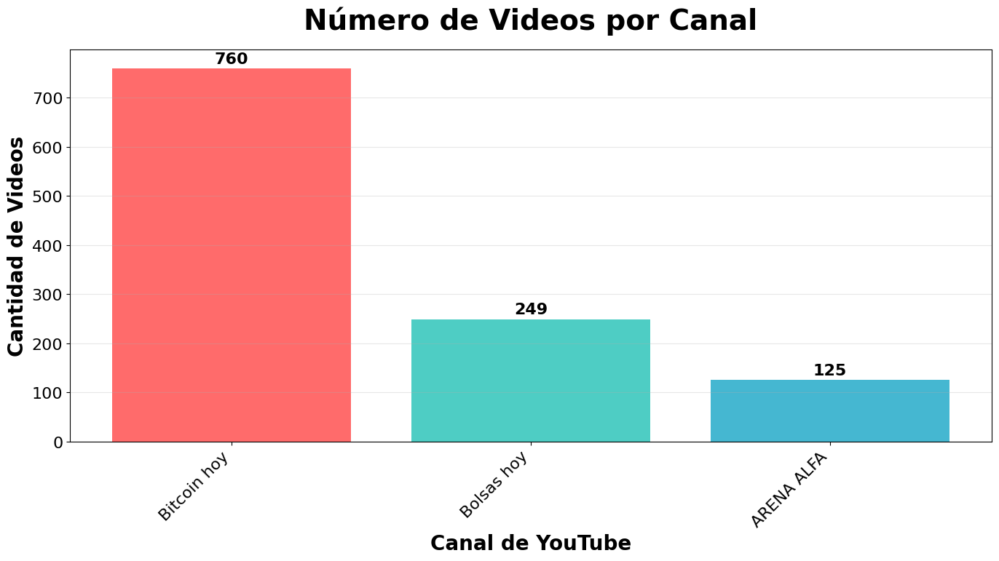

📊 ESTADÍSTICAS DE VIDEOS POR CANAL:
Bitcoin hoy: 760 videos (67.0%)
Bolsas hoy: 249 videos (22.0%)
ARENA ALFA: 125 videos (11.0%)


In [87]:
# GRÁFICO 1: Número de videos por canal
fig, ax = plt.subplots(figsize=(14, 8))

# Contar videos por canal
videos_por_canal = df_youtube['channel_name'].value_counts()

# Crear gráfico de barras
bars = ax.bar(range(len(videos_por_canal)), videos_por_canal.values, 
              color=['#FF6B6B', '#4ECDC4', '#45B7D1', '#96CEB4', '#FFEAA7'])

# Personalizar el gráfico
ax.set_title('Número de Videos por Canal', fontsize=28, fontweight='bold', pad=20)
ax.set_xlabel('Canal de YouTube', fontsize=20, fontweight='bold')
ax.set_ylabel('Cantidad de Videos', fontsize=20, fontweight='bold')

# Configurar etiquetas del eje X
ax.set_xticks(range(len(videos_por_canal)))
ax.set_xticklabels(videos_por_canal.index, rotation=45, ha='right')

# Agregar valores en las barras
for i, bar in enumerate(bars):
    height = bar.get_height()
    ax.text(bar.get_x() + bar.get_width()/2., height + 5,
            f'{int(height)}', ha='center', va='bottom', fontsize=16, fontweight='bold')

# Ajustar layout y mostrar
plt.tight_layout()
plt.grid(axis='y', alpha=0.3)
plt.show()

# Mostrar estadísticas
print("📊 ESTADÍSTICAS DE VIDEOS POR CANAL:")
print("=" * 50)
for canal, cantidad in videos_por_canal.items():
    porcentaje = (cantidad / len(df_youtube)) * 100
    print(f"{canal}: {cantidad} videos ({porcentaje:.1f}%)")


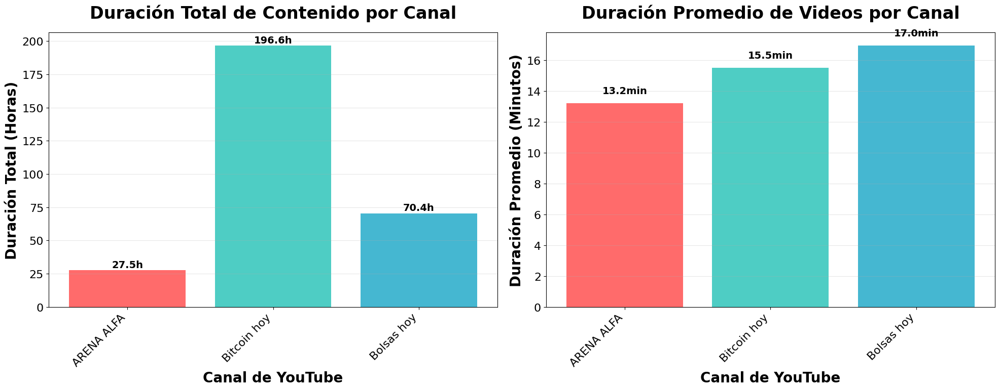


📊 ESTADÍSTICAS DE DURACIÓN POR CANAL:

ARENA ALFA:
  • Total: 27.5 horas (99138 segundos)
  • Promedio: 13.2 minutos (793 segundos)
  • Videos: 125

Bitcoin hoy:
  • Total: 196.6 horas (707728 segundos)
  • Promedio: 15.5 minutos (931 segundos)
  • Videos: 760

Bolsas hoy:
  • Total: 70.4 horas (253427 segundos)
  • Promedio: 17.0 minutos (1018 segundos)
  • Videos: 249


In [88]:
# GRÁFICO 2: Duración total y promedio por canal
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))

# Calcular duración total y promedio por canal
duracion_stats = df_youtube.groupby('channel_name')['duration'].agg(['sum', 'mean', 'count']).reset_index()
duracion_stats.columns = ['canal', 'duracion_total', 'duracion_promedio', 'cantidad_videos']

# Convertir duración de segundos a horas para mejor visualización
duracion_stats['duracion_total_horas'] = duracion_stats['duracion_total'] / 3600
duracion_stats['duracion_promedio_minutos'] = duracion_stats['duracion_promedio'] / 60

# GRÁFICO 2A: Duración total por canal
bars1 = ax1.bar(range(len(duracion_stats)), duracion_stats['duracion_total_horas'], 
                color=['#FF6B6B', '#4ECDC4', '#45B7D1', '#96CEB4', '#FFEAA7'])

ax1.set_title('Duración Total de Contenido por Canal', fontsize=24, fontweight='bold', pad=20)
ax1.set_xlabel('Canal de YouTube', fontsize=20, fontweight='bold')
ax1.set_ylabel('Duración Total (Horas)', fontsize=20, fontweight='bold')

ax1.set_xticks(range(len(duracion_stats)))
ax1.set_xticklabels(duracion_stats['canal'], rotation=45, ha='right')

# Agregar valores en las barras
for i, bar in enumerate(bars1):
    height = bar.get_height()
    ax1.text(bar.get_x() + bar.get_width()/2., height + 0.5,
            f'{height:.1f}h', ha='center', va='bottom', fontsize=14, fontweight='bold')

ax1.grid(axis='y', alpha=0.3)

# GRÁFICO 2B: Duración promedio por canal
bars2 = ax2.bar(range(len(duracion_stats)), duracion_stats['duracion_promedio_minutos'], 
                color=['#FF6B6B', '#4ECDC4', '#45B7D1', '#96CEB4', '#FFEAA7'])

ax2.set_title('Duración Promedio de Videos por Canal', fontsize=24, fontweight='bold', pad=20)
ax2.set_xlabel('Canal de YouTube', fontsize=20, fontweight='bold')
ax2.set_ylabel('Duración Promedio (Minutos)', fontsize=20, fontweight='bold')

ax2.set_xticks(range(len(duracion_stats)))
ax2.set_xticklabels(duracion_stats['canal'], rotation=45, ha='right')

# Agregar valores en las barras
for i, bar in enumerate(bars2):
    height = bar.get_height()
    ax2.text(bar.get_x() + bar.get_width()/2., height + 0.5,
            f'{height:.1f}min', ha='center', va='bottom', fontsize=14, fontweight='bold')

ax2.grid(axis='y', alpha=0.3)

plt.tight_layout()
plt.show()

# Mostrar estadísticas detalladas
print("\n📊 ESTADÍSTICAS DE DURACIÓN POR CANAL:")
print("=" * 70)
for _, row in duracion_stats.iterrows():
    print(f"\n{row['canal']}:")
    print(f"  • Total: {row['duracion_total_horas']:.1f} horas ({row['duracion_total']:.0f} segundos)")
    print(f"  • Promedio: {row['duracion_promedio_minutos']:.1f} minutos ({row['duracion_promedio']:.0f} segundos)")
    print(f"  • Videos: {row['cantidad_videos']}")


In [89]:
import ast

# Cargar el dataset
df_videos_descargados = pd.read_csv("datasets/df_videos_youtube_descargados.csv")

# Convertir frame_paths de string a lista
df_videos_descargados['frame_paths'] = df_videos_descargados['frame_paths'].apply(ast.literal_eval)

In [90]:
df_videos_descargados

,video_id,channel,video_date,video_filename,duration,n_frames,frame_paths
0,tKBpmMwwJaE,Bitcoin hoy ｜ Esteban Perez Trader,20220130,tKBpmMwwJaE_20220130.mp4,1019.333333,510,[frames/Bitcoin hoy ｜ Esteban Perez Trader/tKB...
1,OHqn_ak8cX0,Bitcoin hoy ｜ Esteban Perez Trader,20220829,OHqn_ak8cX0_20220829.mp4,792.666667,397,[frames/Bitcoin hoy ｜ Esteban Perez Trader/OHq...
2,wVKhJhsQfT4,Bitcoin hoy ｜ Esteban Perez Trader,20231207,wVKhJhsQfT4_20231207.mp4,493.566667,247,[frames/Bitcoin hoy ｜ Esteban Perez Trader/wVK...
3,-7ju1t4k4oE,Bitcoin hoy ｜ Esteban Perez Trader,20230411,-7ju1t4k4oE_20230411.mp4,1279.833333,640,[frames/Bitcoin hoy ｜ Esteban Perez Trader/-7j...
4,IRAij7lx8xk,Bitcoin hoy ｜ Esteban Perez Trader,20221206,IRAij7lx8xk_20221206.mp4,961.500000,481,[frames/Bitcoin hoy ｜ Esteban Perez Trader/IRA...
...,...,...,...,...,...,...,...
1128,KfALD5wJIsM,Bolsas hoy ｜ Esteban Pérez Inversor,20240229,KfALD5wJIsM_20240229.mp4,1204.436567,603,[frames/Bolsas hoy ｜ Esteban Pérez Inversor/Kf...
1129,CDjcddrk-ms,Bolsas hoy ｜ Esteban Pérez Inversor,20240115,CDjcddrk-ms_20240115.mp4,484.266667,243,[frames/Bolsas hoy ｜ Esteban Pérez Inversor/CD...
1130,IY8dYm5DoG4,Bolsas hoy ｜ Esteban Pérez Inversor,20240516,IY8dYm5DoG4_20240516.mp4,1821.566667,911,[frames/Bolsas hoy ｜ Esteban Pérez Inversor/IY...
1131,VGdofDNzcss,Bolsas hoy ｜ Esteban Pérez Inversor,20240429,VGdofDNzcss_20240429.mp4,1916.133333,959,[frames/Bolsas hoy ｜ Esteban Pérez Inversor/VG...


In [92]:
# Crear un diccionario de mapeo para los cambios

channel_mapping = {
    'ARENA ALFA ': 'ARENA ALFA',
    'Bitcoin hoy ｜ Esteban Perez Trader': 'Bitcoin hoy',
    'Bolsas hoy ｜ Esteban Pérez Inversor': 'Bolsas hoy'
}

# Aplicar los cambios al DataFrame
df_videos_descargados['channel_name'] = df_videos_descargados['channel'].replace(channel_mapping)

Total de videos: 1133
=== PROPUESTA 1: Diversidad por Canal ===


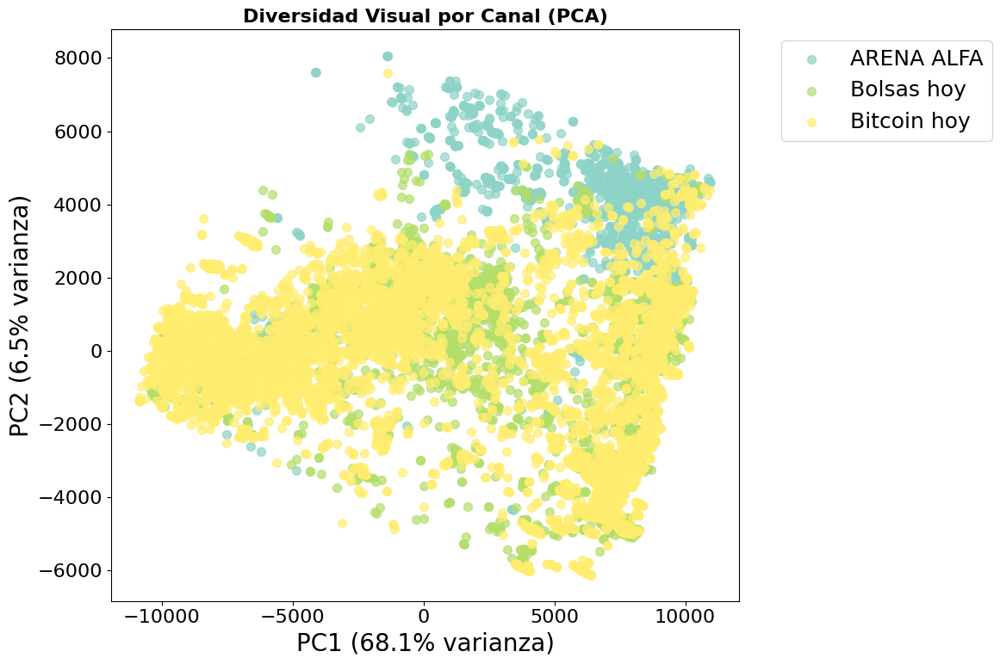


=== PROPUESTA 2: Gráfico Limpio con Información Visual ===


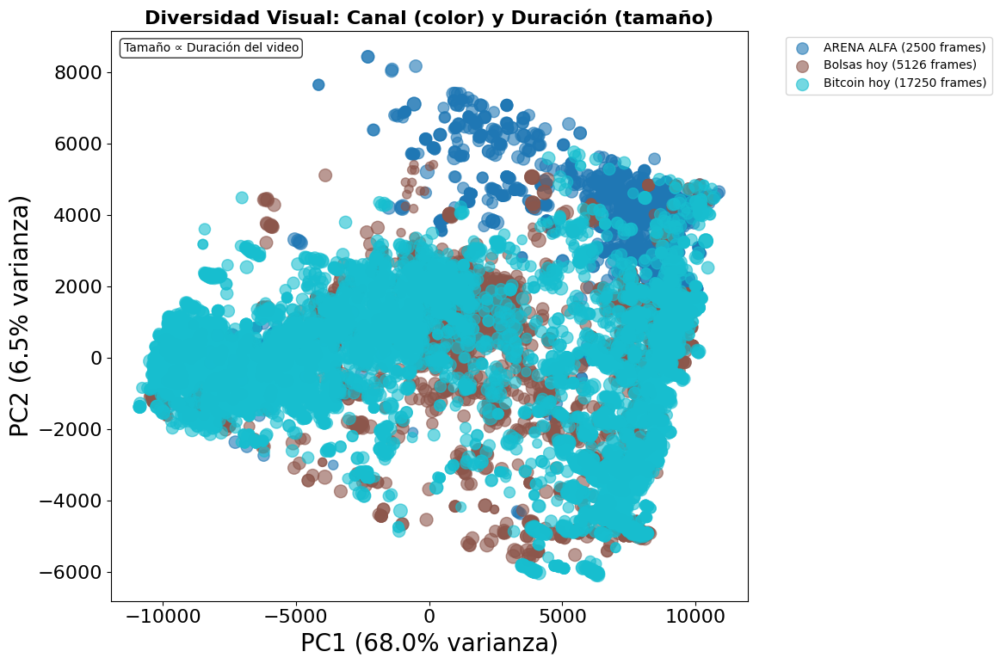


=== PROPUESTA 3: Subplots por Canal ===


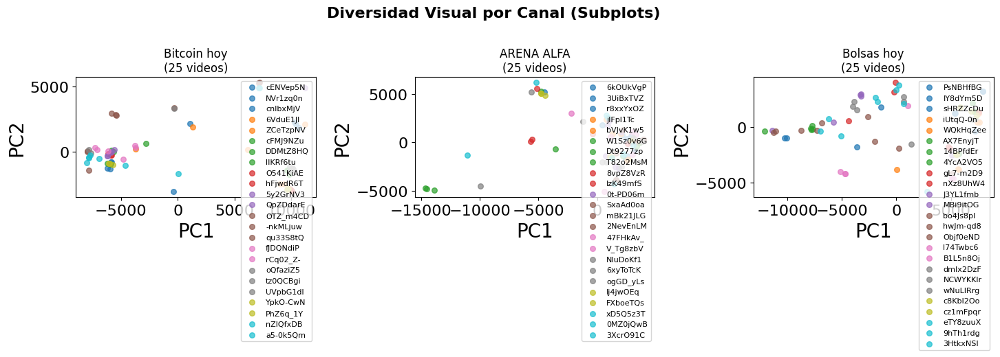

In [100]:
# ----------- 6. EMBEDDINGS Y DIVERSIDAD VISUAL (MEJORADO) -----------
from sklearn.decomposition import PCA
import matplotlib.patches as mpatches

# Verificar cuántos videos tenemos
print(f"Total de videos: {len(df_videos_descargados)}")

# PROPUESTA 1: Muestra representativa con colores por canal
def plot_diversity_by_channel(max_videos=20, max_frames_per_video=5):
    """
    Crea un gráfico de diversidad visual agrupando por canal
    """
    # Tomar una muestra representativa
    if len(df_videos_descargados) > max_videos:
        sample_df = df_videos_descargados.sample(n=max_videos, random_state=42)
    else:
        sample_df = df_videos_descargados.copy()
    
    # Preparar datos
    sample_images = []
    sample_labels = []
    sample_channels = []
    
    for i, row in sample_df.iterrows():
        n_frames = min(max_frames_per_video, len(row['frame_paths']))
        for fp in np.random.choice(row['frame_paths'], n_frames, replace=False):
            img = Image.open(fp).resize((60, 45)).convert('RGB')
            arr = np.array(img).flatten()
            sample_images.append(arr)
            sample_labels.append(row['video_id'])
            sample_channels.append(row['channel_name'])
    
    X = np.stack(sample_images)
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X)
    
    # Crear gráfico con colores por canal
    plt.figure(figsize=(12, 8))
    
    # Obtener canales únicos y asignar colores
    unique_channels = list(set(sample_channels))
    colors = plt.cm.Set3(np.linspace(0, 1, len(unique_channels)))
    channel_colors = dict(zip(unique_channels, colors))
    
    # Plotear por canal
    for channel in unique_channels:
        mask = [ch == channel for ch in sample_channels]
        plt.scatter(X_pca[mask, 0], X_pca[mask, 1], 
                   c=[channel_colors[channel]], 
                   label=channel, alpha=0.7, s=50)
    
    plt.xlabel(f'PC1 ({pca.explained_variance_ratio_[0]:.1%} varianza)')
    plt.ylabel(f'PC2 ({pca.explained_variance_ratio_[1]:.1%} varianza)')
    plt.title('Diversidad Visual por Canal (PCA)', fontsize=16, fontweight='bold')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()

# PROPUESTA 2: Gráfico sin leyenda, con tooltips informativos
def plot_diversity_clean(max_videos=30, max_frames_per_video=3):
    """
    Gráfico limpio sin leyenda, usando colores y tamaños para información
    """
    # Muestra representativa
    if len(df_videos_descargados) > max_videos:
        sample_df = df_videos_descargados.sample(n=max_videos, random_state=42)
    else:
        sample_df = df_videos_descargados.copy()
    
    # Preparar datos
    sample_images = []
    video_info = []
    
    for i, row in sample_df.iterrows():
        n_frames = min(max_frames_per_video, len(row['frame_paths']))
        for fp in np.random.choice(row['frame_paths'], n_frames, replace=False):
            img = Image.open(fp).resize((60, 45)).convert('RGB')
            arr = np.array(img).flatten()
            sample_images.append(arr)
            video_info.append({
                'video_id': row['video_id'],
                'channel': row['channel_name'],
                'duration': row['duration'],
                'n_frames': len(row['frame_paths'])
            })
    
    X = np.stack(sample_images)
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X)
    
    # Crear gráfico
    fig, ax = plt.subplots(figsize=(12, 8))
    
    # Colores por canal, tamaño por duración
    channels = [info['channel'] for info in video_info]
    durations = [info['duration'] for info in video_info]
    
    unique_channels = list(set(channels))
    colors = plt.cm.tab10(np.linspace(0, 1, len(unique_channels)))
    channel_colors = dict(zip(unique_channels, colors))
    
    # Normalizar duraciones para tamaños
    max_duration = max(durations) if durations else 1
    sizes = [50 + (d/max_duration) * 100 for d in durations]
    
    for channel in unique_channels:
        mask = [ch == channel for ch in channels]
        channel_sizes = [sizes[i] for i, m in enumerate(mask) if m]
        channel_durations = [durations[i] for i, m in enumerate(mask) if m]
        
        scatter = ax.scatter([X_pca[i, 0] for i, m in enumerate(mask) if m],
                           [X_pca[i, 1] for i, m in enumerate(mask) if m],
                           c=[channel_colors[channel]], 
                           s=channel_sizes,
                           alpha=0.6,
                           label=f'{channel} ({sum(mask)} frames)')
    
    ax.set_xlabel(f'PC1 ({pca.explained_variance_ratio_[0]:.1%} varianza)')
    ax.set_ylabel(f'PC2 ({pca.explained_variance_ratio_[1]:.1%} varianza)')
    ax.set_title('Diversidad Visual: Canal (color) y Duración (tamaño)', fontsize=16, fontweight='bold')
    
    # Leyenda más compacta
    ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=10)
    
    # Agregar texto explicativo
    ax.text(0.02, 0.98, 'Tamaño ∝ Duración del video', 
            transform=ax.transAxes, fontsize=10, 
            bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8),
            verticalalignment='top')
    
    plt.tight_layout()
    plt.show()

# PROPUESTA 3: Gráfico interactivo con subplots por canal
def plot_diversity_by_channel_subplots(max_videos_per_channel=5):
    """
    Crear subplots separados por canal para mejor visualización
    """
    # Agrupar por canal
    if 'channel_name' in df_videos_descargados.columns:
        channels = df_videos_descargados['channel_name'].unique()
        n_channels = len(channels)
        
        # Calcular grid de subplots
        n_cols = min(3, n_channels)
        n_rows = (n_channels + n_cols - 1) // n_cols
        
        fig, axes = plt.subplots(n_rows, n_cols, figsize=(5*n_cols, 4*n_rows))
        
        # Asegurar que axes sea siempre un array 2D para acceso consistente
        if n_channels == 1:
            axes = np.array([[axes]])
        elif n_rows == 1:
            axes = axes.reshape(1, -1)
        elif n_cols == 1:
            axes = axes.reshape(-1, 1)
        
        for idx, channel in enumerate(channels):
            row = idx // n_cols
            col = idx % n_cols
            ax = axes[row, col]
            
            # Filtrar videos del canal
            channel_videos = df_videos_descargados[df_videos_descargados['channel_name'] == channel]
            sample_videos = channel_videos.sample(n=min(max_videos_per_channel, len(channel_videos)), 
                                                random_state=42)
            
            # Preparar datos para este canal
            sample_images = []
            sample_labels = []
            
            for i, row in sample_videos.iterrows():
                n_frames = min(3, len(row['frame_paths']))
                for fp in np.random.choice(row['frame_paths'], n_frames, replace=False):
                    img = Image.open(fp).resize((60, 45)).convert('RGB')
                    arr = np.array(img).flatten()
                    sample_images.append(arr)
                    sample_labels.append(row['video_id'])
            
            if sample_images:
                X = np.stack(sample_images)
                pca = PCA(n_components=2)
                X_pca = pca.fit_transform(X)
                
                # Plotear
                unique_videos = list(set(sample_labels))
                colors = plt.cm.tab10(np.linspace(0, 1, len(unique_videos)))
                
                for i, video_id in enumerate(unique_videos):
                    mask = [l == video_id for l in sample_labels]
                    ax.scatter([X_pca[j, 0] for j, m in enumerate(mask) if m],
                             [X_pca[j, 1] for j, m in enumerate(mask) if m],
                             c=[colors[i]], label=video_id[:8], alpha=0.7, s=30)
                
                ax.set_title(f'{channel}\n({len(sample_videos)} videos)', fontsize=12)
                ax.set_xlabel('PC1')
                ax.set_ylabel('PC2')
                ax.legend(fontsize=8, loc='upper right')
        
        # Ocultar subplots vacíos
        for idx in range(n_channels, n_rows * n_cols):
            row = idx // n_cols
            col = idx % n_cols
            axes[row, col].set_visible(False)
        
        plt.suptitle('Diversidad Visual por Canal (Subplots)', fontsize=16, fontweight='bold')
        plt.tight_layout()
        plt.show()
    else:
        print("No hay información de canal disponible")

# Ejecutar las propuestas
print("=== PROPUESTA 1: Diversidad por Canal ===")
plot_diversity_by_channel(max_videos= 500, max_frames_per_video= 50)

print("\n=== PROPUESTA 2: Gráfico Limpio con Información Visual ===")
plot_diversity_clean(max_videos= 500, max_frames_per_video= 50)

print("\n=== PROPUESTA 3: Subplots por Canal ===")
plot_diversity_by_channel_subplots( max_videos_per_channel= 25)


In [101]:
 def plot_diversity_by_similarity(max_videos=500, max_frames_per_video=50, n_clusters=5):
    """
    Clustering de frames por similitud visual usando K-means
    """
    # Muestra representativa
    if len(df_videos_descargados) > max_videos:
        sample_df = df_videos_descargados.sample(n=max_videos, random_state=42)
    else:
        sample_df = df_videos_descargados.copy()
    
    # Preparar datos
    sample_images = []
    frame_info = []
    
    for i, row in sample_df.iterrows():
        n_frames = min(max_frames_per_video, len(row['frame_paths']))
        for fp in np.random.choice(row['frame_paths'], n_frames, replace=False):
            img = Image.open(fp).resize((60, 45)).convert('RGB')
            arr = np.array(img).flatten()
            sample_images.append(arr)
            frame_info.append({
                'video_id': row['video_id'],
                'channel': row['channel_name'],
                'frame_path': fp,
                'duration': row['duration']
            })
    
    X = np.stack(sample_images)
    
    # PCA para reducción de dimensionalidad
    pca = PCA(n_components=50)  # Reducir a 50 componentes
    X_pca = pca.fit_transform(X)
    
    # K-means clustering
    from sklearn.cluster import KMeans
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    cluster_labels = kmeans.fit_predict(X_pca)
    
    # PCA para visualización (2D)
    pca_2d = PCA(n_components=2)
    X_2d = pca_2d.fit_transform(X_pca)
    
    # Crear gráfico
    plt.figure(figsize=(14, 10))
    
    # Colores por cluster
    colors = plt.cm.tab10(np.linspace(0, 1, n_clusters))
    
    for cluster_id in range(n_clusters):
        mask = cluster_labels == cluster_id
        plt.scatter(X_2d[mask, 0], X_2d[mask, 1], 
                   c=[colors[cluster_id]], 
                   label=f'Cluster {cluster_id}', 
                   alpha=0.7, s=50)
    
    plt.xlabel(f'PC1 ({pca_2d.explained_variance_ratio_[0]:.1%} varianza)')
    plt.ylabel(f'PC2 ({pca_2d.explained_variance_ratio_[1]:.1%} varianza)')
    plt.title(f'Clustering por Similitud Visual (K={n_clusters})', fontsize=16, fontweight='bold')
    plt.legend()
    plt.tight_layout()
    plt.show()
    
    # Análisis de clusters
    print(f"\n=== ANÁLISIS DE CLUSTERS ===")
    for cluster_id in range(n_clusters):
        cluster_frames = [frame_info[i] for i in range(len(frame_info)) if cluster_labels[i] == cluster_id]
        channels_in_cluster = [f['channel'] for f in cluster_frames]
        channel_counts = pd.Series(channels_in_cluster).value_counts()
        
        print(f"\nCluster {cluster_id} ({len(cluster_frames)} frames):")
        for channel, count in channel_counts.items():
            print(f"  - {channel}: {count} frames ({count/len(cluster_frames):.1%})")
    
    return cluster_labels, frame_info, X_2d

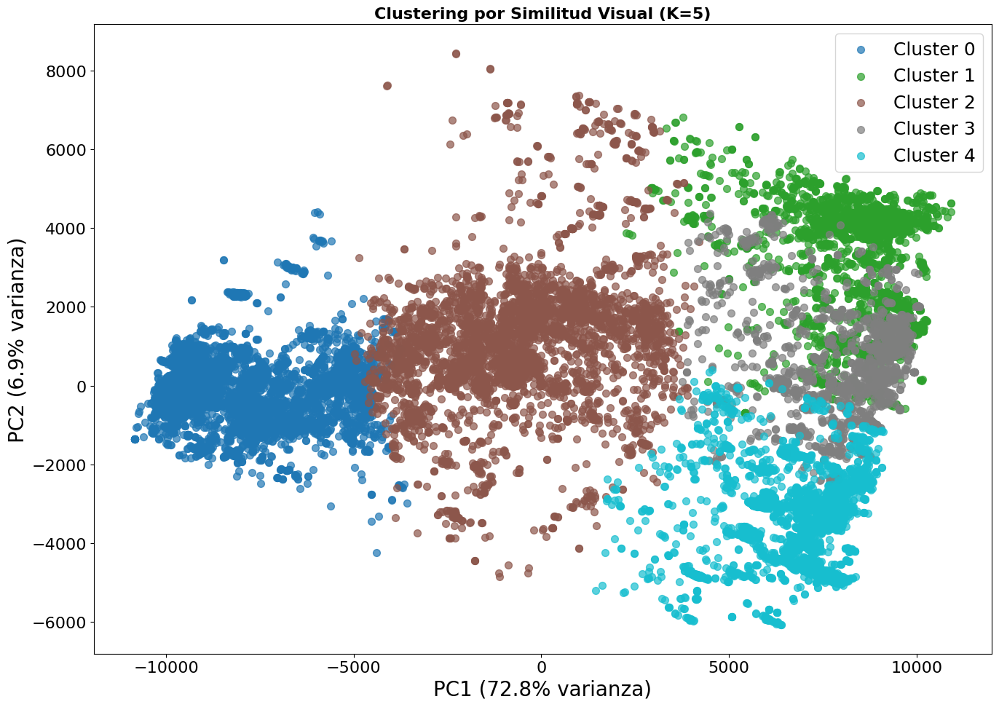


=== ANÁLISIS DE CLUSTERS ===

Cluster 0 (9815 frames):
  - Bitcoin hoy: 8940 frames (91.1%)
  - Bolsas hoy: 735 frames (7.5%)
  - ARENA ALFA: 140 frames (1.4%)

Cluster 1 (3667 frames):
  - ARENA ALFA: 1951 frames (53.2%)
  - Bitcoin hoy: 1477 frames (40.3%)
  - Bolsas hoy: 239 frames (6.5%)

Cluster 2 (4430 frames):
  - Bitcoin hoy: 2517 frames (56.8%)
  - Bolsas hoy: 1555 frames (35.1%)
  - ARENA ALFA: 358 frames (8.1%)

Cluster 3 (2564 frames):
  - Bitcoin hoy: 1373 frames (53.5%)
  - Bolsas hoy: 1155 frames (45.0%)
  - ARENA ALFA: 36 frames (1.4%)

Cluster 4 (4400 frames):
  - Bitcoin hoy: 2943 frames (66.9%)
  - Bolsas hoy: 1442 frames (32.8%)
  - ARENA ALFA: 15 frames (0.3%)


(array([2, 1, 1, ..., 4, 4, 2], shape=(24876,), dtype=int32),
 [{'video_id': 'wEO7-DD0rT4',
   'channel': 'ARENA ALFA',
   'frame_path': np.str_('frames/ARENA ALFA /wEO7-DD0rT4_20241129_frame12000.jpg'),
   'duration': 605.72},
  {'video_id': 'wEO7-DD0rT4',
   'channel': 'ARENA ALFA',
   'frame_path': np.str_('frames/ARENA ALFA /wEO7-DD0rT4_20241129_frame1250.jpg'),
   'duration': 605.72},
  {'video_id': 'wEO7-DD0rT4',
   'channel': 'ARENA ALFA',
   'frame_path': np.str_('frames/ARENA ALFA /wEO7-DD0rT4_20241129_frame9100.jpg'),
   'duration': 605.72},
  {'video_id': 'wEO7-DD0rT4',
   'channel': 'ARENA ALFA',
   'frame_path': np.str_('frames/ARENA ALFA /wEO7-DD0rT4_20241129_frame5200.jpg'),
   'duration': 605.72},
  {'video_id': 'wEO7-DD0rT4',
   'channel': 'ARENA ALFA',
   'frame_path': np.str_('frames/ARENA ALFA /wEO7-DD0rT4_20241129_frame12150.jpg'),
   'duration': 605.72},
  {'video_id': 'wEO7-DD0rT4',
   'channel': 'ARENA ALFA',
   'frame_path': np.str_('frames/ARENA ALFA /wEO7-DD0

In [103]:
plot_diversity_by_similarity(max_videos=500, max_frames_per_video=50, n_clusters=5)

In [104]:
def show_cluster_mosaics(max_videos=500, max_frames_per_video=50, n_clusters=5, n_samples_per_cluster=12):
    """
    Muestra mosaicos de frames representativos de cada cluster
    """
    # Muestra representativa
    if len(df_videos_descargados) > max_videos:
        sample_df = df_videos_descargados.sample(n=max_videos, random_state=42)
    else:
        sample_df = df_videos_descargados.copy()
    
    # Preparar datos
    sample_images = []
    frame_info = []
    
    for i, row in sample_df.iterrows():
        n_frames = min(max_frames_per_video, len(row['frame_paths']))
        for fp in np.random.choice(row['frame_paths'], n_frames, replace=False):
            img = Image.open(fp).resize((60, 45)).convert('RGB')
            arr = np.array(img).flatten()
            sample_images.append(arr)
            frame_info.append({
                'video_id': row['video_id'],
                'channel': row['channel_name'],
                'frame_path': fp,
                'duration': row['duration']
            })
    
    X = np.stack(sample_images)
    
    # PCA para reducción de dimensionalidad
    pca = PCA(n_components=50)
    X_pca = pca.fit_transform(X)
    
    # K-means clustering
    from sklearn.cluster import KMeans
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    cluster_labels = kmeans.fit_predict(X_pca)
    
    # Crear mosaicos para cada cluster
    fig, axes = plt.subplots(n_clusters, 1, figsize=(15, 3*n_clusters))
    if n_clusters == 1:
        axes = [axes]
    
    for cluster_id in range(n_clusters):
        # Obtener frames de este cluster
        cluster_indices = [i for i, label in enumerate(cluster_labels) if label == cluster_id]
        
        # Seleccionar muestras representativas
        n_samples = min(n_samples_per_cluster, len(cluster_indices))
        selected_indices = np.random.choice(cluster_indices, n_samples, replace=False)
        
        # Crear mosaico
        mosaic_images = []
        for idx in selected_indices:
            img = Image.open(frame_info[idx]['frame_path']).resize((80, 60))
            mosaic_images.append(np.array(img))
        
        # Calcular grid para el mosaico
        cols = min(6, n_samples)
        rows = (n_samples + cols - 1) // cols
        
        # Crear imagen del mosaico
        mosaic_width = cols * 80
        mosaic_height = rows * 60
        mosaic = np.zeros((mosaic_height, mosaic_width, 3), dtype=np.uint8)
        
        for i, img in enumerate(mosaic_images):
            row = i // cols
            col = i % cols
            y_start = row * 60
            y_end = y_start + 60
            x_start = col * 80
            x_end = x_start + 80
            mosaic[y_start:y_end, x_start:x_end] = img
        
        # Mostrar mosaico
        axes[cluster_id].imshow(mosaic)
        axes[cluster_id].set_title(f'Cluster {cluster_id} - {len(cluster_indices)} frames total', 
                                 fontsize=14, fontweight='bold')
        axes[cluster_id].axis('off')
        
        # Agregar información del cluster
        channels_in_cluster = [frame_info[i]['channel'] for i in cluster_indices]
        channel_counts = pd.Series(channels_in_cluster).value_counts()
        info_text = "Canales: " + ", ".join([f"{ch}({count})" for ch, count in channel_counts.items()])
        axes[cluster_id].text(0.02, 0.98, info_text, transform=axes[cluster_id].transAxes, 
                            fontsize=10, verticalalignment='top',
                            bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8))
    
    plt.tight_layout()
    plt.show()
    
    # Análisis detallado de clusters
    print(f"\n=== ANÁLISIS DETALLADO DE CLUSTERS ===")
    for cluster_id in range(n_clusters):
        cluster_indices = [i for i, label in enumerate(cluster_labels) if label == cluster_id]
        cluster_frames = [frame_info[i] for i in cluster_indices]
        channels_in_cluster = [f['channel'] for f in cluster_frames]
        channel_counts = pd.Series(channels_in_cluster).value_counts()
        
        print(f"\n🔍 Cluster {cluster_id} ({len(cluster_frames)} frames):")
        for channel, count in channel_counts.items():
            print(f"  📺 {channel}: {count} frames ({count/len(cluster_frames):.1%})")
        
        # Mostrar algunos ejemplos de paths
        print(f"  📁 Ejemplos de frames:")
        for i, frame in enumerate(cluster_frames[:3]):
            print(f"    {i+1}. {frame['video_id']} - {frame['channel']}")
    
    return cluster_labels, frame_info


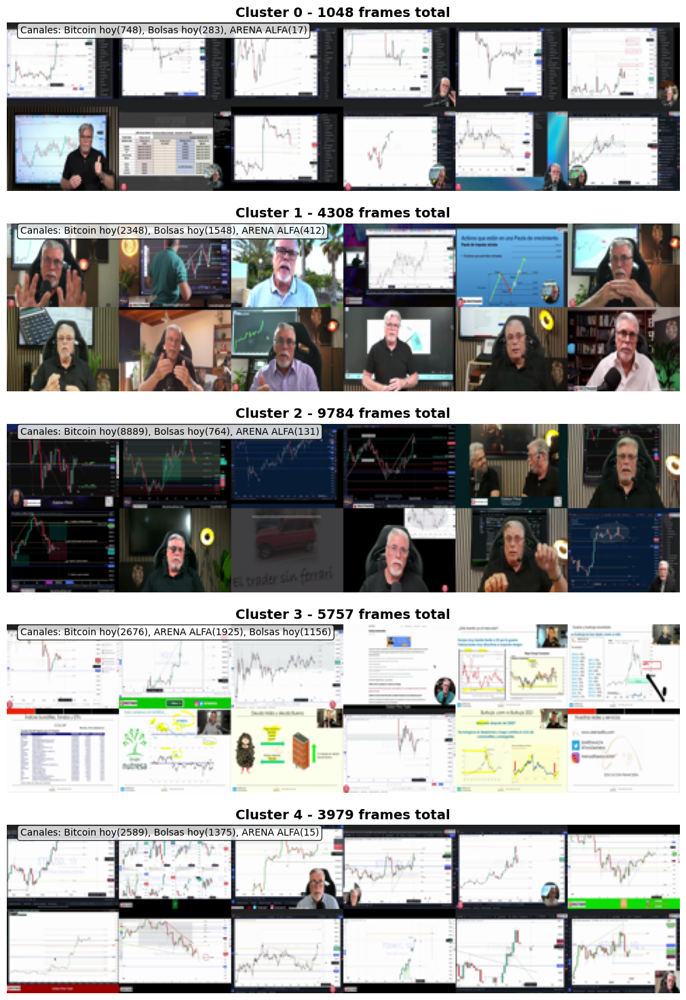


=== ANÁLISIS DETALLADO DE CLUSTERS ===

🔍 Cluster 0 (1048 frames):
  📺 Bitcoin hoy: 748 frames (71.4%)
  📺 Bolsas hoy: 283 frames (27.0%)
  📺 ARENA ALFA: 17 frames (1.6%)
  📁 Ejemplos de frames:
    1. AKeuY_q3Go0 - Bolsas hoy
    2. AKeuY_q3Go0 - Bolsas hoy
    3. AKeuY_q3Go0 - Bolsas hoy

🔍 Cluster 1 (4308 frames):
  📺 Bitcoin hoy: 2348 frames (54.5%)
  📺 Bolsas hoy: 1548 frames (35.9%)
  📺 ARENA ALFA: 412 frames (9.6%)
  📁 Ejemplos de frames:
    1. wEO7-DD0rT4 - ARENA ALFA
    2. wEO7-DD0rT4 - ARENA ALFA
    3. wEO7-DD0rT4 - ARENA ALFA

🔍 Cluster 2 (9784 frames):
  📺 Bitcoin hoy: 8889 frames (90.9%)
  📺 Bolsas hoy: 764 frames (7.8%)
  📺 ARENA ALFA: 131 frames (1.3%)
  📁 Ejemplos de frames:
    1. wEO7-DD0rT4 - ARENA ALFA
    2. wEO7-DD0rT4 - ARENA ALFA
    3. 9o8q7n3fjwU - Bitcoin hoy

🔍 Cluster 3 (5757 frames):
  📺 Bitcoin hoy: 2676 frames (46.5%)
  📺 ARENA ALFA: 1925 frames (33.4%)
  📺 Bolsas hoy: 1156 frames (20.1%)
  📁 Ejemplos de frames:
    1. wEO7-DD0rT4 - ARENA ALFA
    2.

(array([3, 3, 1, ..., 4, 1, 4], shape=(24876,), dtype=int32),
 [{'video_id': 'wEO7-DD0rT4',
   'channel': 'ARENA ALFA',
   'frame_path': np.str_('frames/ARENA ALFA /wEO7-DD0rT4_20241129_frame6500.jpg'),
   'duration': 605.72},
  {'video_id': 'wEO7-DD0rT4',
   'channel': 'ARENA ALFA',
   'frame_path': np.str_('frames/ARENA ALFA /wEO7-DD0rT4_20241129_frame12800.jpg'),
   'duration': 605.72},
  {'video_id': 'wEO7-DD0rT4',
   'channel': 'ARENA ALFA',
   'frame_path': np.str_('frames/ARENA ALFA /wEO7-DD0rT4_20241129_frame13850.jpg'),
   'duration': 605.72},
  {'video_id': 'wEO7-DD0rT4',
   'channel': 'ARENA ALFA',
   'frame_path': np.str_('frames/ARENA ALFA /wEO7-DD0rT4_20241129_frame1550.jpg'),
   'duration': 605.72},
  {'video_id': 'wEO7-DD0rT4',
   'channel': 'ARENA ALFA',
   'frame_path': np.str_('frames/ARENA ALFA /wEO7-DD0rT4_20241129_frame4250.jpg'),
   'duration': 605.72},
  {'video_id': 'wEO7-DD0rT4',
   'channel': 'ARENA ALFA',
   'frame_path': np.str_('frames/ARENA ALFA /wEO7-DD0

In [105]:
# Mostrar mosaicos de cada cluster
show_cluster_mosaics(max_videos=500, max_frames_per_video=50, n_clusters=5, n_samples_per_cluster=12)


In [106]:
def show_detailed_cluster_mosaic(cluster_id, max_videos=500, max_frames_per_video=50, n_clusters=5, n_samples=24):
    """
    Muestra un mosaico detallado de un cluster específico
    """
    # Muestra representativa
    if len(df_videos_descargados) > max_videos:
        sample_df = df_videos_descargados.sample(n=max_videos, random_state=42)
    else:
        sample_df = df_videos_descargados.copy()
    
    # Preparar datos
    sample_images = []
    frame_info = []
    
    for i, row in sample_df.iterrows():
        n_frames = min(max_frames_per_video, len(row['frame_paths']))
        for fp in np.random.choice(row['frame_paths'], n_frames, replace=False):
            img = Image.open(fp).resize((60, 45)).convert('RGB')
            arr = np.array(img).flatten()
            sample_images.append(arr)
            frame_info.append({
                'video_id': row['video_id'],
                'channel': row['channel_name'],
                'frame_path': fp,
                'duration': row['duration']
            })
    
    X = np.stack(sample_images)
    
    # PCA para reducción de dimensionalidad
    pca = PCA(n_components=50)
    X_pca = pca.fit_transform(X)
    
    # K-means clustering
    from sklearn.cluster import KMeans
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    cluster_labels = kmeans.fit_predict(X_pca)
    
    # Obtener frames del cluster específico
    cluster_indices = [i for i, label in enumerate(cluster_labels) if label == cluster_id]
    
    if len(cluster_indices) == 0:
        print(f"No hay frames en el cluster {cluster_id}")
        return
    
    # Seleccionar muestras representativas
    n_samples = min(n_samples, len(cluster_indices))
    selected_indices = np.random.choice(cluster_indices, n_samples, replace=False)
    
    # Crear mosaico
    mosaic_images = []
    for idx in selected_indices:
        img = Image.open(frame_info[idx]['frame_path']).resize((120, 90))
        mosaic_images.append(np.array(img))
    
    # Calcular grid para el mosaico
    cols = min(8, n_samples)
    rows = (n_samples + cols - 1) // cols
    
    # Crear imagen del mosaico
    mosaic_width = cols * 120
    mosaic_height = rows * 90
    mosaic = np.zeros((mosaic_height, mosaic_width, 3), dtype=np.uint8)
    
    for i, img in enumerate(mosaic_images):
        row = i // cols
        col = i % cols
        y_start = row * 90
        y_end = y_start + 90
        x_start = col * 120
        x_end = x_start + 120
        mosaic[y_start:y_end, x_start:x_end] = img
    
    # Mostrar mosaico
    plt.figure(figsize=(16, 2*rows))
    plt.imshow(mosaic)
    plt.title(f'Cluster {cluster_id} - Mosaico Detallado ({len(cluster_indices)} frames total)', 
              fontsize=16, fontweight='bold')
    plt.axis('off')
    
    # Análisis del cluster
    cluster_frames = [frame_info[i] for i in cluster_indices]
    channels_in_cluster = [f['channel'] for f in cluster_frames]
    channel_counts = pd.Series(channels_in_cluster).value_counts()
    
    print(f"\n📊 ANÁLISIS DEL CLUSTER {cluster_id}")
    print(f"Total de frames: {len(cluster_indices)}")
    print(f"Distribución por canal:")
    for channel, count in channel_counts.items():
        print(f"  📺 {channel}: {count} frames ({count/len(cluster_indices):.1%})")
    
    plt.tight_layout()
    plt.show()
    
    return cluster_indices, cluster_frames



📊 ANÁLISIS DEL CLUSTER 0
Total de frames: 9738
Distribución por canal:
  📺 Bitcoin hoy: 8867 frames (91.1%)
  📺 Bolsas hoy: 740 frames (7.6%)
  📺 ARENA ALFA: 131 frames (1.3%)


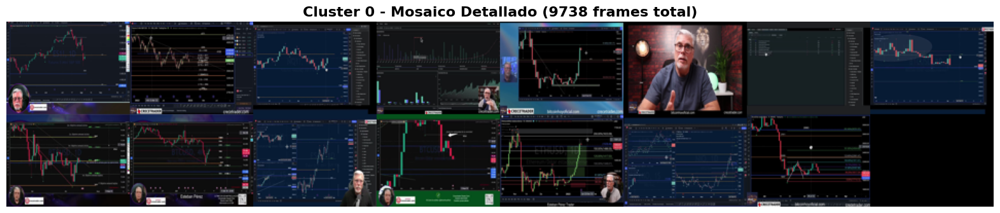


📊 ANÁLISIS DEL CLUSTER 1
Total de frames: 5854
Distribución por canal:
  📺 Bitcoin hoy: 2667 frames (45.6%)
  📺 ARENA ALFA: 1909 frames (32.6%)
  📺 Bolsas hoy: 1278 frames (21.8%)


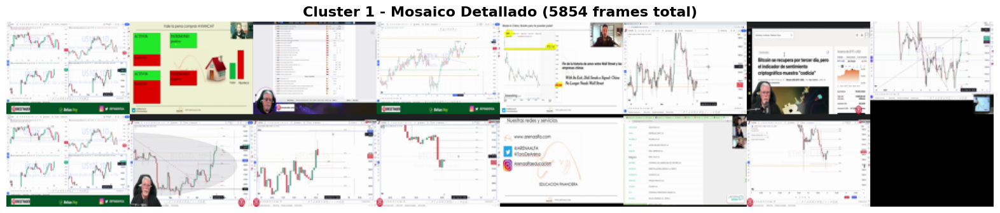


📊 ANÁLISIS DEL CLUSTER 2
Total de frames: 2930
Distribución por canal:
  📺 Bitcoin hoy: 1321 frames (45.1%)
  📺 Bolsas hoy: 1239 frames (42.3%)
  📺 ARENA ALFA: 370 frames (12.6%)


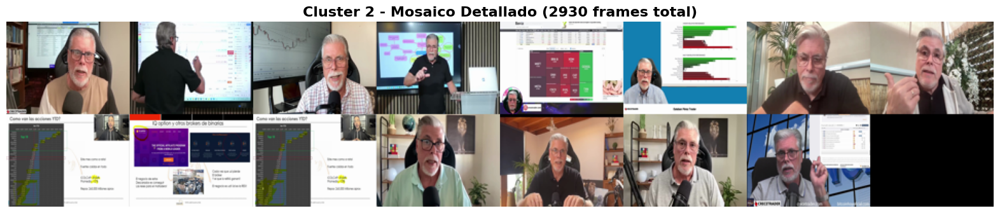


📊 ANÁLISIS DEL CLUSTER 3
Total de frames: 4457
Distribución por canal:
  📺 Bitcoin hoy: 2982 frames (66.9%)
  📺 Bolsas hoy: 1459 frames (32.7%)
  📺 ARENA ALFA: 16 frames (0.4%)


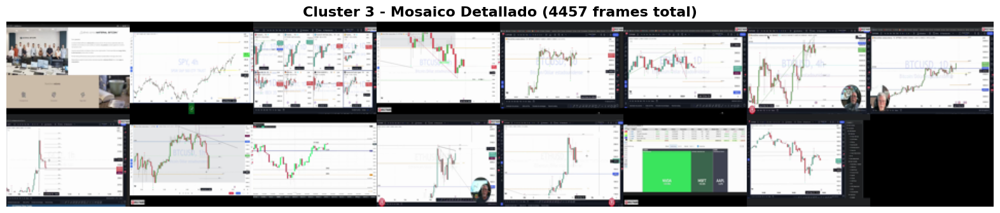


📊 ANÁLISIS DEL CLUSTER 4
Total de frames: 5784
Distribución por canal:
  📺 Bitcoin hoy: 2618 frames (45.3%)
  📺 ARENA ALFA: 1897 frames (32.8%)
  📺 Bolsas hoy: 1269 frames (21.9%)


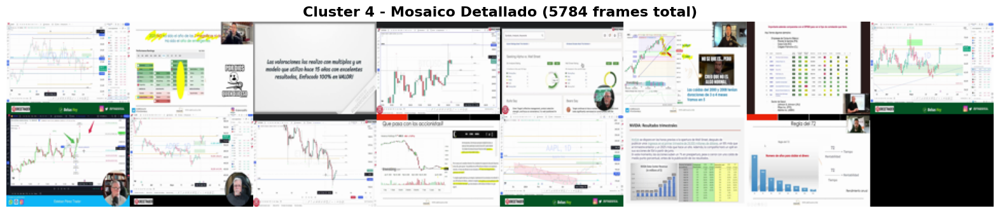

([0,
  1,
  4,
  6,
  7,
  8,
  11,
  12,
  13,
  15,
  17,
  18,
  20,
  22,
  24,
  25,
  27,
  28,
  29,
  30,
  31,
  33,
  34,
  35,
  36,
  37,
  38,
  39,
  41,
  42,
  43,
  44,
  45,
  46,
  47,
  48,
  49,
  51,
  52,
  55,
  59,
  60,
  63,
  65,
  66,
  68,
  69,
  71,
  73,
  74,
  75,
  79,
  88,
  90,
  91,
  95,
  96,
  112,
  116,
  134,
  136,
  191,
  200,
  202,
  205,
  206,
  209,
  210,
  212,
  213,
  215,
  216,
  219,
  220,
  221,
  222,
  224,
  225,
  226,
  227,
  229,
  230,
  233,
  234,
  235,
  236,
  237,
  238,
  240,
  243,
  244,
  245,
  247,
  249,
  251,
  260,
  262,
  263,
  300,
  302,
  303,
  307,
  308,
  309,
  310,
  311,
  312,
  314,
  315,
  316,
  317,
  318,
  320,
  321,
  322,
  324,
  325,
  327,
  328,
  329,
  331,
  332,
  333,
  334,
  335,
  336,
  337,
  338,
  339,
  340,
  341,
  342,
  344,
  345,
  347,
  348,
  349,
  355,
  356,
  357,
  358,
  376,
  389,
  394,
  474,
  475,
  478,
  479,
  480,
  482,
  483,
  484,

In [107]:
# Ejemplos de uso para ver mosaicos detallados de clusters específicos
# Descomenta la línea que quieras ejecutar:

# Ver mosaico detallado del cluster 0
show_detailed_cluster_mosaic(cluster_id=0, n_samples=15)

# Ver mosaico detallado del cluster 1  
show_detailed_cluster_mosaic(cluster_id=1, n_samples=15)

# Ver mosaico detallado del cluster 2
show_detailed_cluster_mosaic(cluster_id=2, n_samples=15)

# Ver mosaico detallado del cluster 3
show_detailed_cluster_mosaic(cluster_id=3, n_samples=15)

# Ver mosaico detallado del cluster 4
show_detailed_cluster_mosaic(cluster_id=4, n_samples=15)


=== PROPUESTA 4: Análisis con Clustering ===


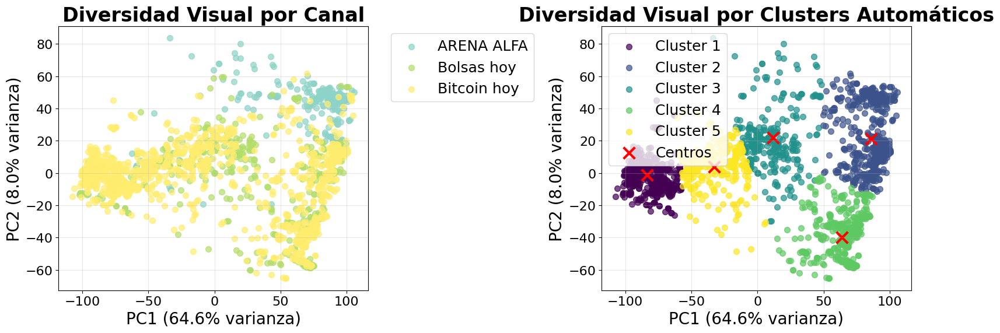


=== ANÁLISIS DE CLUSTERS ===
Cluster 1: 875 frames
  Canales: ARENA ALFA, Bolsas hoy, Bitcoin hoy
  Videos únicos: 250

Cluster 2: 586 frames
  Canales: ARENA ALFA, Bolsas hoy, Bitcoin hoy
  Videos únicos: 181

Cluster 3: 267 frames
  Canales: ARENA ALFA, Bolsas hoy, Bitcoin hoy
  Videos únicos: 115

Cluster 4: 463 frames
  Canales: ARENA ALFA, Bolsas hoy, Bitcoin hoy
  Videos únicos: 150

Cluster 5: 309 frames
  Canales: ARENA ALFA, Bolsas hoy, Bitcoin hoy
  Videos únicos: 167


=== PROPUESTA 5: Heatmap de Similitud ===


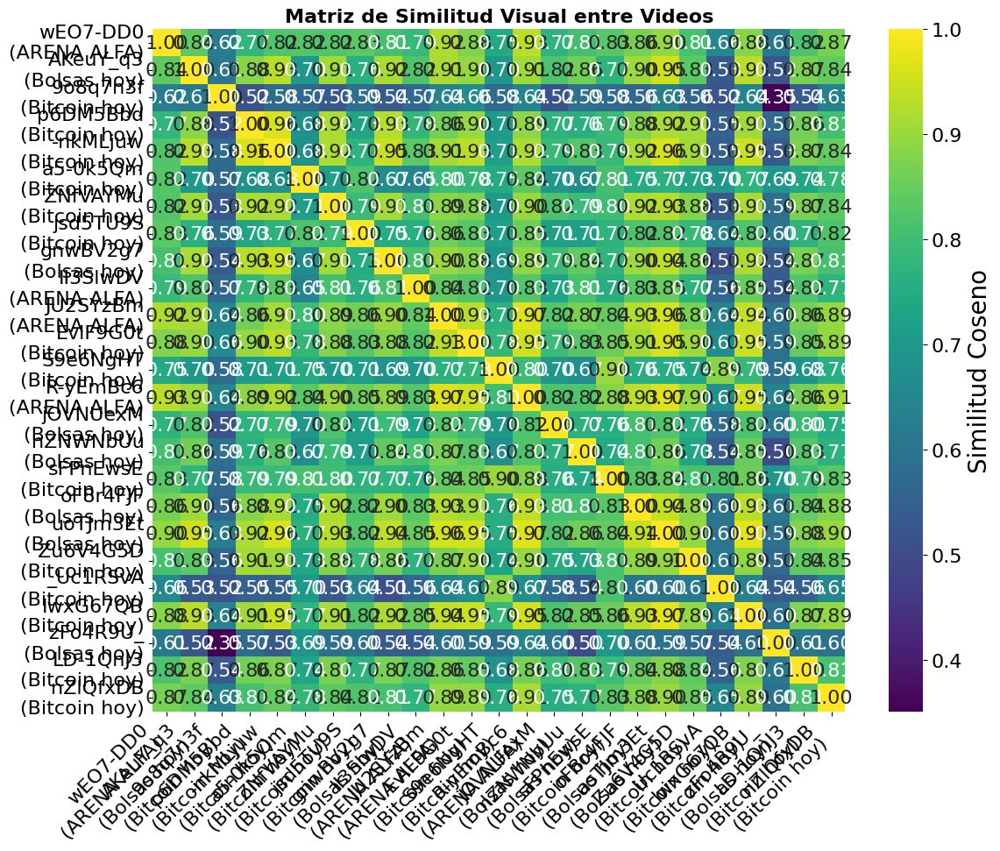

In [ ]:
# ----------- PROPUESTA 4: ANÁLISIS AVANZADO CON CLUSTERING -----------
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

def plot_diversity_with_clustering(max_videos=25, n_clusters=5):
    """
    Análisis de diversidad visual con clustering automático
    """
    # Muestra representativa
    if len(df_videos_descargados) > max_videos:
        sample_df = df_videos_descargados.sample(n=max_videos, random_state=42)
    else:
        sample_df = df_videos_descargados.copy()
    
    # Preparar datos
    sample_images = []
    video_metadata = []
    
    for i, row in sample_df.iterrows():
        n_frames = min(5, len(row['frame_paths']))
        for fp in np.random.choice(row['frame_paths'], n_frames, replace=False):
            img = Image.open(fp).resize((60, 45)).convert('RGB')
            arr = np.array(img).flatten()
            sample_images.append(arr)
            video_metadata.append({
                'video_id': row['video_id'],
                'channel': row.get('channel_name', 'Unknown'),
                'duration': row.get('duration', 0),
                'n_frames': len(row['frame_paths'])
            })
    
    X = np.stack(sample_images)
    
    # Normalizar datos
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)
    
    # PCA
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X_scaled)
    
    # Clustering
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    clusters = kmeans.fit_predict(X_pca)
    
    # Crear gráfico
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))
    
    # Gráfico 1: Por canal
    channels = [info['channel'] for info in video_metadata]
    unique_channels = list(set(channels))
    colors = plt.cm.Set3(np.linspace(0, 1, len(unique_channels)))
    channel_colors = dict(zip(unique_channels, colors))
    
    for channel in unique_channels:
        mask = [ch == channel for ch in channels]
        ax1.scatter([X_pca[i, 0] for i, m in enumerate(mask) if m],
                   [X_pca[i, 1] for i, m in enumerate(mask) if m],
                   c=[channel_colors[channel]], 
                   label=channel, alpha=0.7, s=50)
    
    ax1.set_xlabel(f'PC1 ({pca.explained_variance_ratio_[0]:.1%} varianza)')
    ax1.set_ylabel(f'PC2 ({pca.explained_variance_ratio_[1]:.1%} varianza)')
    ax1.set_title('Diversidad Visual por Canal', fontweight='bold')
    ax1.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    ax1.grid(True, alpha=0.3)
    
    # Gráfico 2: Por clusters
    cluster_colors = plt.cm.viridis(np.linspace(0, 1, n_clusters))
    for i in range(n_clusters):
        mask = clusters == i
        ax2.scatter(X_pca[mask, 0], X_pca[mask, 1], 
                   c=[cluster_colors[i]], 
                   label=f'Cluster {i+1}', alpha=0.7, s=50)
    
    # Centros de clusters
    ax2.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1],
               c='red', marker='x', s=200, linewidths=3, label='Centros')
    
    ax2.set_xlabel(f'PC1 ({pca.explained_variance_ratio_[0]:.1%} varianza)')
    ax2.set_ylabel(f'PC2 ({pca.explained_variance_ratio_[1]:.1%} varianza)')
    ax2.set_title('Diversidad Visual por Clusters Automáticos', fontweight='bold')
    ax2.legend()
    ax2.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.show()
    
    # Análisis de clusters
    print("\n=== ANÁLISIS DE CLUSTERS ===")
    for i in range(n_clusters):
        cluster_mask = clusters == i
        cluster_videos = [video_metadata[j] for j, m in enumerate(cluster_mask) if m]
        channels_in_cluster = [v['channel'] for v in cluster_videos]
        unique_channels_cluster = list(set(channels_in_cluster))
        
        print(f"Cluster {i+1}: {sum(cluster_mask)} frames")
        print(f"  Canales: {', '.join(unique_channels_cluster)}")
        print(f"  Videos únicos: {len(set([v['video_id'] for v in cluster_videos]))}")
        print()

# PROPUESTA 5: Heatmap de similitud entre videos
def plot_video_similarity_heatmap(max_videos=15):
    """
    Crear un heatmap de similitud entre videos
    """
    # Muestra representativa
    if len(df_videos_descargados) > max_videos:
        sample_df = df_videos_descargados.sample(n=max_videos, random_state=42)
    else:
        sample_df = df_videos_descargados.copy()
    
    # Preparar datos - un vector promedio por video
    video_features = []
    video_info = []
    
    for i, row in sample_df.iterrows():
        # Tomar algunos frames representativos
        n_frames = min(3, len(row['frame_paths']))
        frames = np.random.choice(row['frame_paths'], n_frames, replace=False)
        
        # Promediar los features de los frames
        frame_features = []
        for fp in frames:
            img = Image.open(fp).resize((60, 45)).convert('RGB')
            arr = np.array(img).flatten()
            frame_features.append(arr)
        
        # Promedio de features
        avg_features = np.mean(frame_features, axis=0)
        video_features.append(avg_features)
        video_info.append({
            'video_id': row['video_id'][:8],  # Truncar para el heatmap
            'channel': row.get('channel_name', 'Unknown')
        })
    
    X = np.stack(video_features)
    
    # Calcular matriz de similitud (coseno)
    from sklearn.metrics.pairwise import cosine_similarity
    similarity_matrix = cosine_similarity(X)
    
    # Crear heatmap
    plt.figure(figsize=(12, 10))
    
    # Etiquetas para el heatmap
    labels = [f"{info['video_id']}\n({info['channel']})" for info in video_info]
    
    # Crear heatmap
    sns.heatmap(similarity_matrix, 
                xticklabels=labels,
                yticklabels=labels,
                annot=True, 
                fmt='.2f',
                cmap='viridis',
                cbar_kws={'label': 'Similitud Coseno'})
    
    plt.title('Matriz de Similitud Visual entre Videos', fontsize=16, fontweight='bold')
    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.show()

# Ejecutar propuestas avanzadas
print("=== PROPUESTA 4: Análisis con Clustering ===")
plot_diversity_with_clustering(max_videos = 500,n_clusters= 5)

print("\n=== PROPUESTA 5: Heatmap de Similitud ===")
plot_video_similarity_heatmap(max_videos= 20)


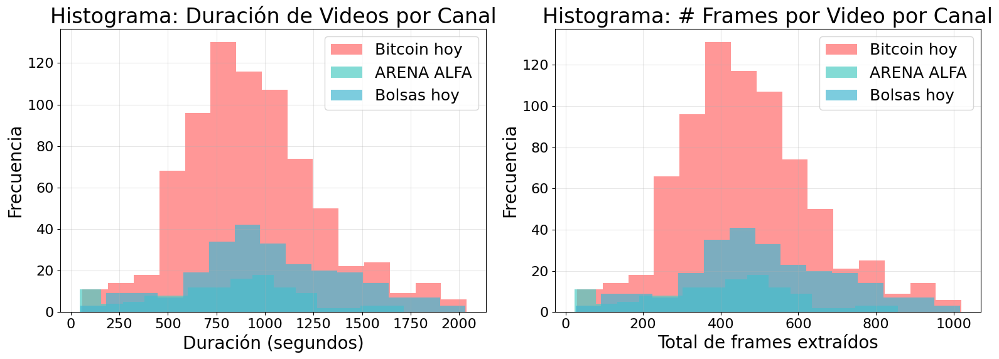

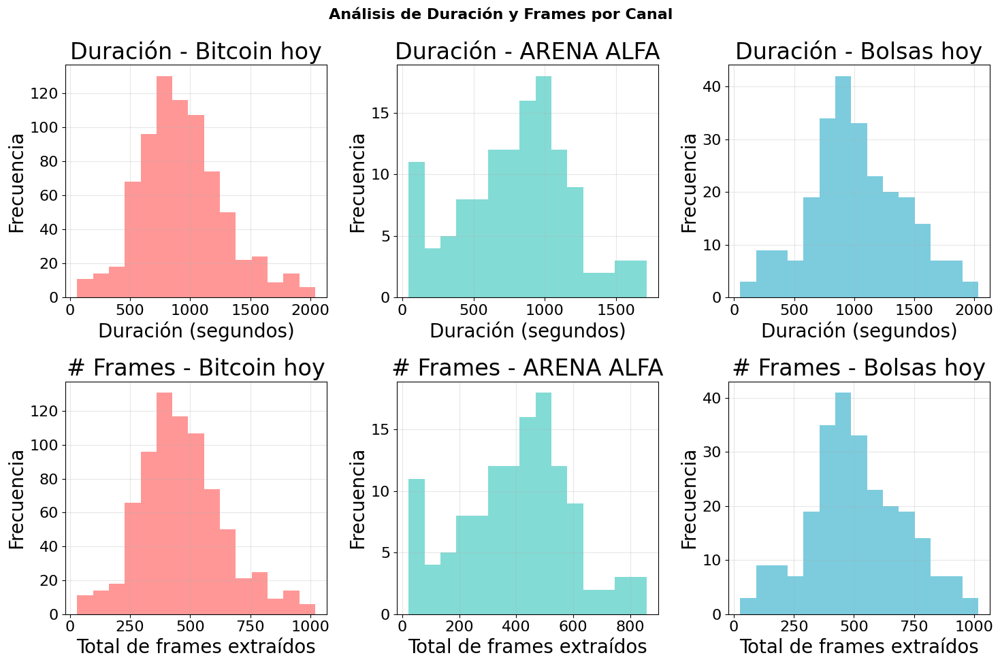

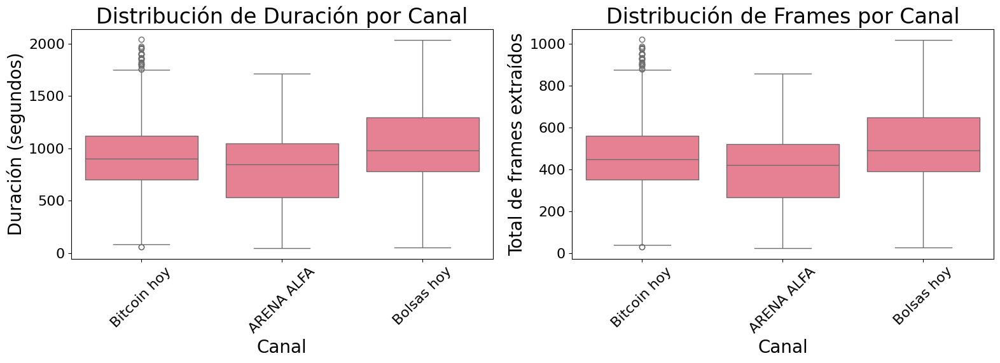

📊 ESTADÍSTICAS POR CANAL:

Bitcoin hoy:
  • Videos: 759
  • Duración promedio: 931.4 segundos (15.5 minutos)
  • Duración mediana: 897.9 segundos
  • Frames promedio: 466.2
  • Frames mediana: 449.0
  • Duración min/max: 60.0 / 2038.7 segundos
  • Frames min/max: 30 / 1020

ARENA ALFA:
  • Videos: 125
  • Duración promedio: 796.6 segundos (13.3 minutos)
  • Duración mediana: 843.9 segundos
  • Frames promedio: 398.8
  • Frames mediana: 422.0
  • Duración min/max: 44.9 / 1713.3 segundos
  • Frames min/max: 23 / 857

Bolsas hoy:
  • Videos: 249
  • Duración promedio: 1017.5 segundos (17.0 minutos)
  • Duración mediana: 980.0 segundos
  • Frames promedio: 509.2
  • Frames mediana: 491.0
  • Duración min/max: 50.5 / 2033.0 segundos
  • Frames min/max: 26 / 1017


In [95]:
# ----------- 3. EDA BÁSICO Y VISUALIZACIÓN POR CANAL -----------

# OPCIÓN 1: Histogramas superpuestos por canal
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

# Histograma de duración por canal
canales = df_videos_descargados['channel_name'].unique()
colores = ['#FF6B6B', '#4ECDC4', '#45B7D1', '#96CEB4', '#FFEAA7']

for i, canal in enumerate(canales):
    datos_canal = df_videos_descargados[df_videos_descargados['channel_name'] == canal]['duration']
    ax1.hist(datos_canal, bins=15, alpha=0.7, label=canal, color=colores[i % len(colores)])

ax1.set_xlabel('Duración (segundos)')
ax1.set_ylabel('Frecuencia')
ax1.set_title('Histograma: Duración de Videos por Canal')
ax1.legend()
ax1.grid(True, alpha=0.3)

# Histograma de frames por canal
for i, canal in enumerate(canales):
    datos_canal = df_videos_descargados[df_videos_descargados['channel_name'] == canal]['n_frames']
    ax2.hist(datos_canal, bins=15, alpha=0.7, label=canal, color=colores[i % len(colores)])

ax2.set_xlabel('Total de frames extraídos')
ax2.set_ylabel('Frecuencia')
ax2.set_title('Histograma: # Frames por Video por Canal')
ax2.legend()
ax2.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# OPCIÓN 2: Histogramas en subplots separados por canal
n_canales = len(canales)
fig, axes = plt.subplots(2, n_canales, figsize=(5*n_canales, 10))

# Asegurar que axes sea 2D
if n_canales == 1:
    axes = axes.reshape(2, 1)

for i, canal in enumerate(canales):
    datos_canal = df_videos_descargados[df_videos_descargados['channel_name'] == canal]
    
    # Histograma de duración
    axes[0, i].hist(datos_canal['duration'], bins=15, alpha=0.7, color=colores[i % len(colores)])
    axes[0, i].set_xlabel('Duración (segundos)')
    axes[0, i].set_ylabel('Frecuencia')
    axes[0, i].set_title(f'Duración - {canal}')
    axes[0, i].grid(True, alpha=0.3)
    
    # Histograma de frames
    axes[1, i].hist(datos_canal['n_frames'], bins=15, alpha=0.7, color=colores[i % len(colores)])
    axes[1, i].set_xlabel('Total de frames extraídos')
    axes[1, i].set_ylabel('Frecuencia')
    axes[1, i].set_title(f'# Frames - {canal}')
    axes[1, i].grid(True, alpha=0.3)

plt.suptitle('Análisis de Duración y Frames por Canal', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

# OPCIÓN 3: Boxplots por canal para mejor comparación
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

# Boxplot de duración por canal
sns.boxplot(data=df_videos_descargados, x='channel_name', y='duration', ax=ax1)
ax1.set_xlabel('Canal')
ax1.set_ylabel('Duración (segundos)')
ax1.set_title('Distribución de Duración por Canal')
ax1.tick_params(axis='x', rotation=45)

# Boxplot de frames por canal
sns.boxplot(data=df_videos_descargados, x='channel_name', y='n_frames', ax=ax2)
ax2.set_xlabel('Canal')
ax2.set_ylabel('Total de frames extraídos')
ax2.set_title('Distribución de Frames por Canal')
ax2.tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

# Estadísticas por canal
print("📊 ESTADÍSTICAS POR CANAL:")
print("=" * 60)
for canal in canales:
    datos_canal = df_videos_descargados[df_videos_descargados['channel_name'] == canal]
    print(f"\n{canal}:")
    print(f"  • Videos: {len(datos_canal)}")
    print(f"  • Duración promedio: {datos_canal['duration'].mean():.1f} segundos ({datos_canal['duration'].mean()/60:.1f} minutos)")
    print(f"  • Duración mediana: {datos_canal['duration'].median():.1f} segundos")
    print(f"  • Frames promedio: {datos_canal['n_frames'].mean():.1f}")
    print(f"  • Frames mediana: {datos_canal['n_frames'].median():.1f}")
    print(f"  • Duración min/max: {datos_canal['duration'].min():.1f} / {datos_canal['duration'].max():.1f} segundos")
    print(f"  • Frames min/max: {datos_canal['n_frames'].min()} / {datos_canal['n_frames'].max()}")


=== CANAL: Bitcoin hoy ===


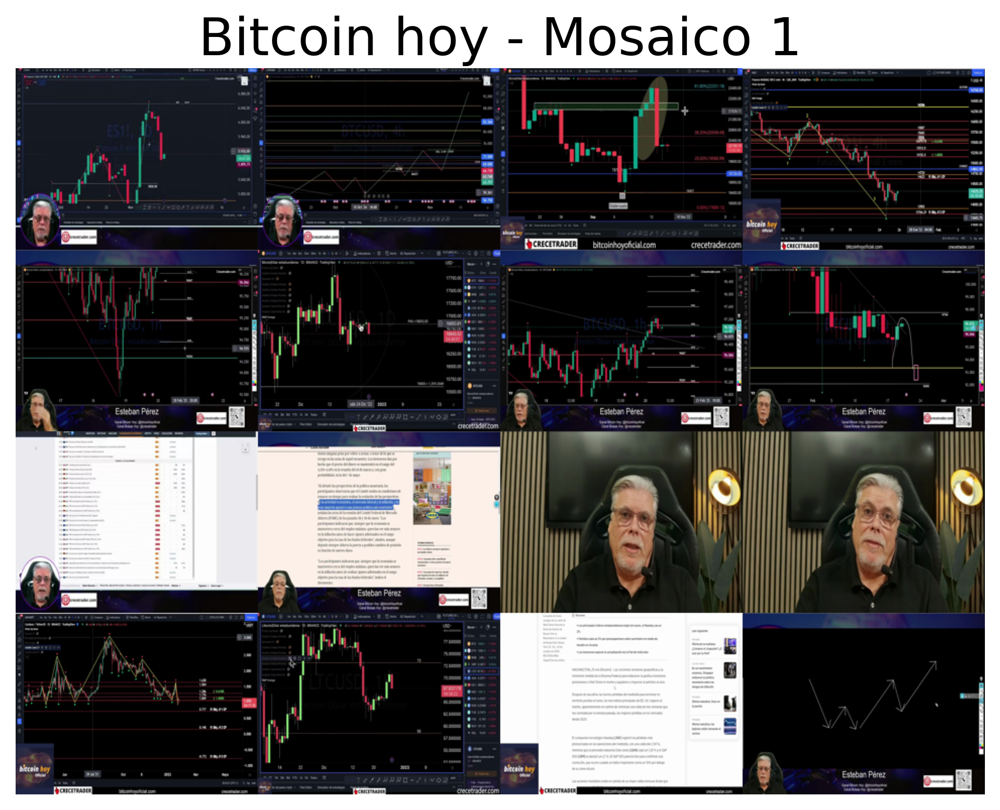

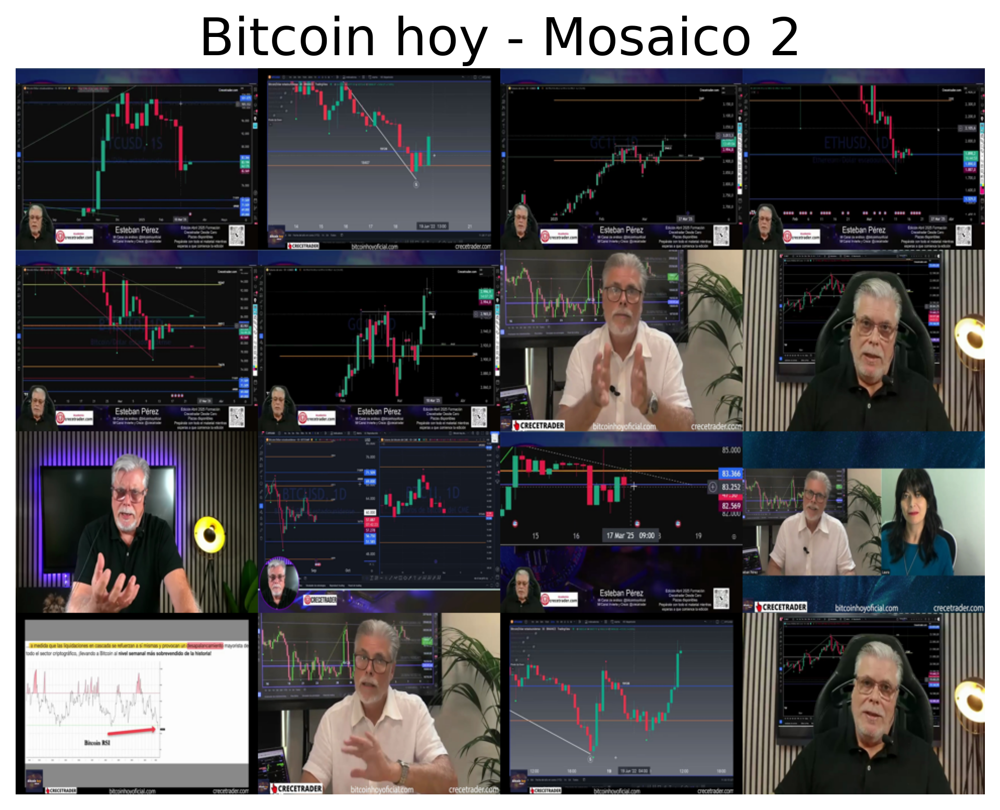


=== CANAL: ARENA ALFA ===


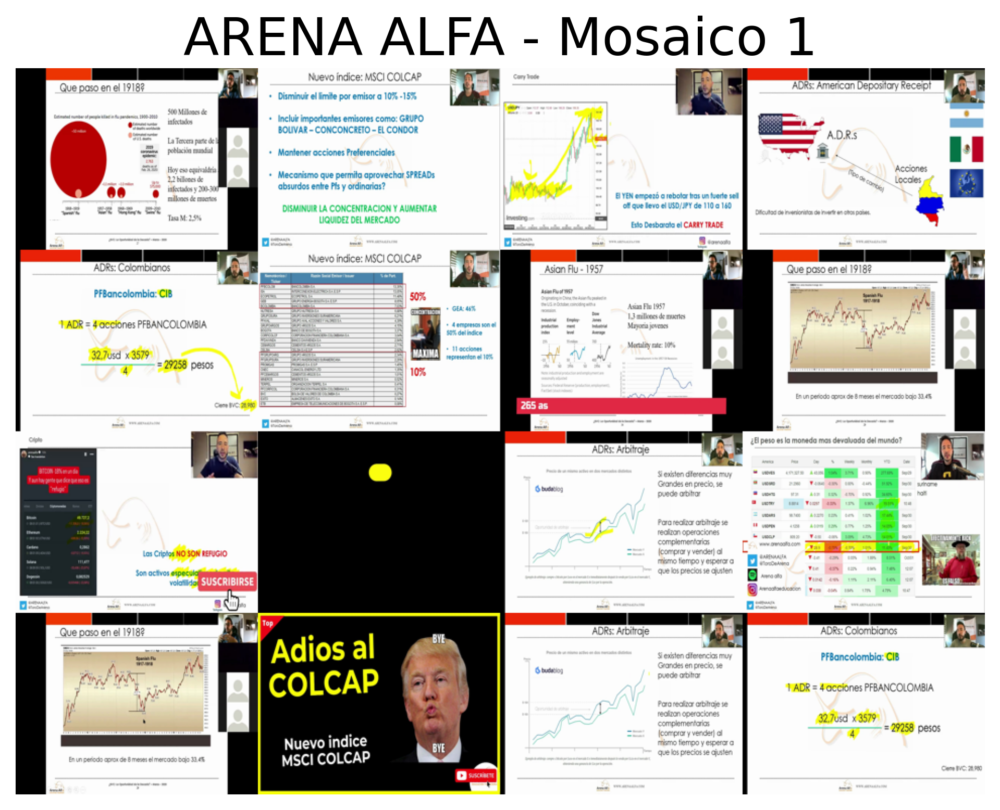

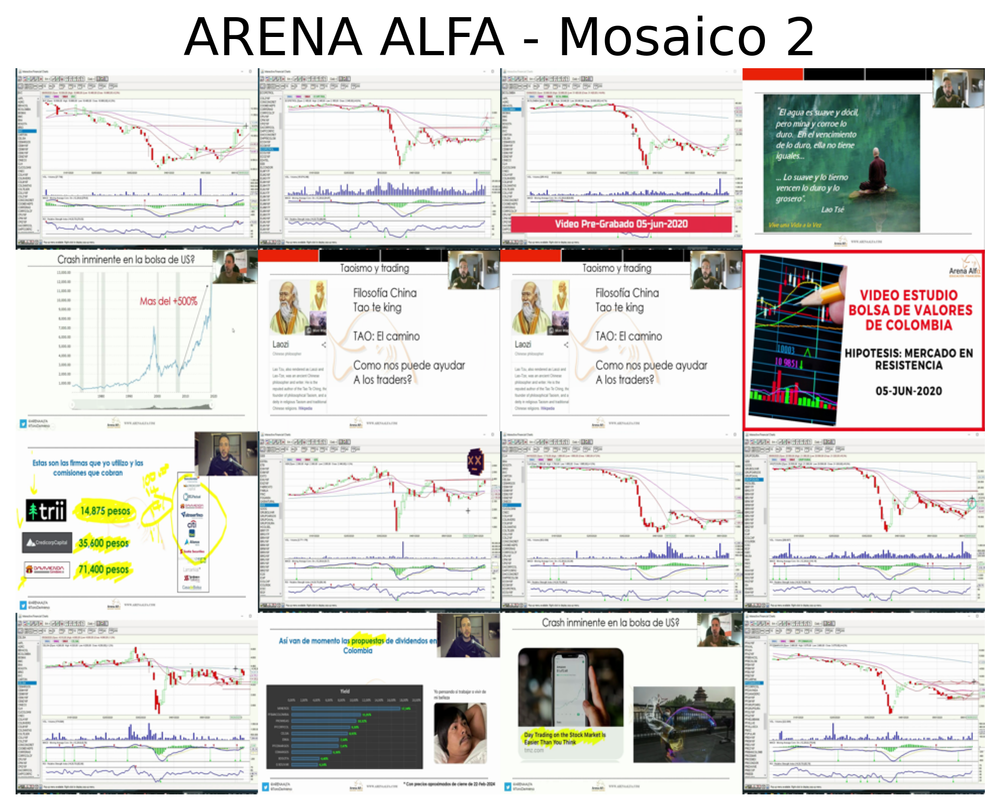


=== CANAL: Bolsas hoy ===


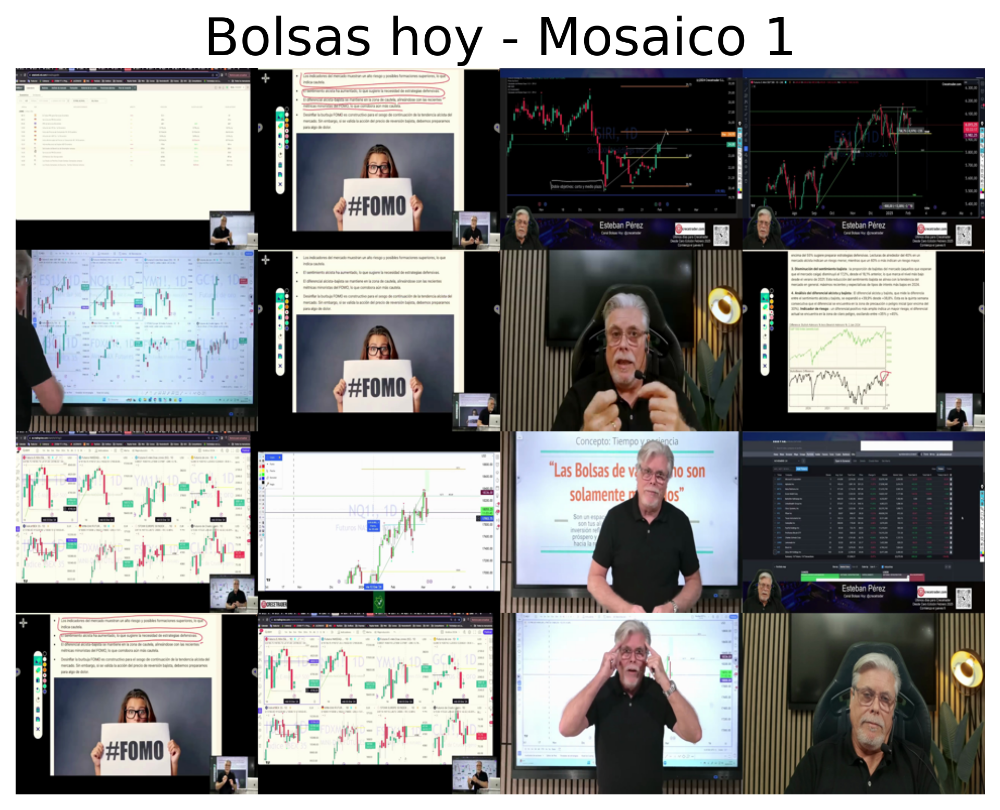

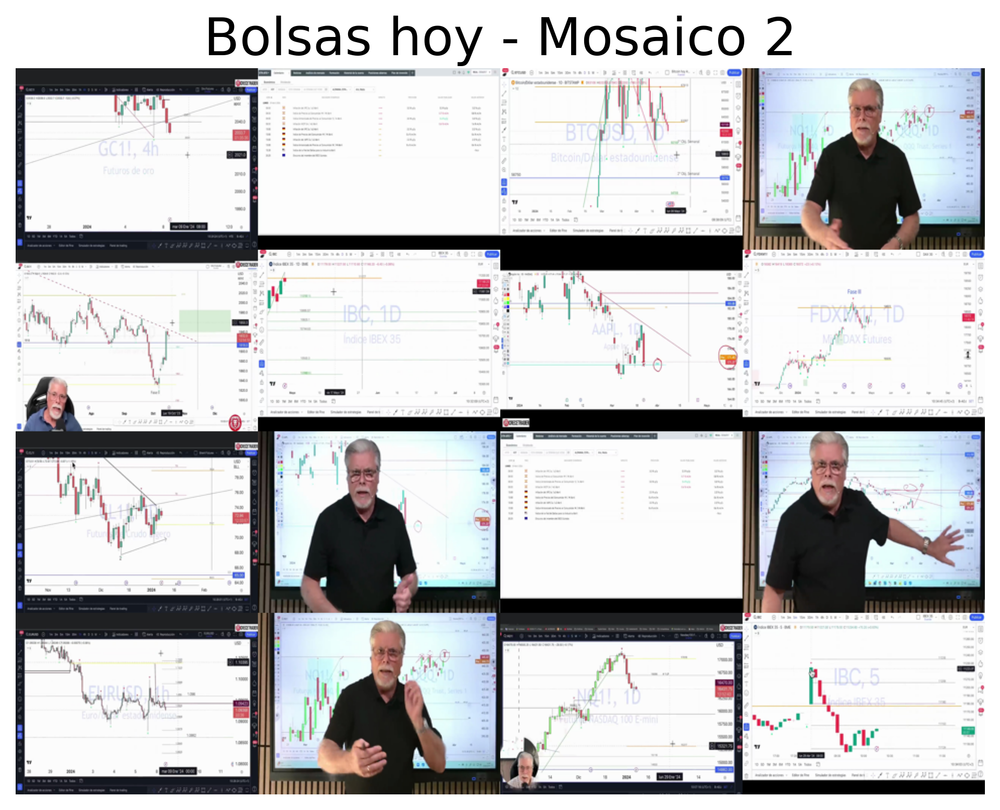

In [73]:
plt.rcParams['figure.dpi'] = 300  # Alta resolución
plt.rcParams['savefig.dpi'] = 300
# ----------- 4. MOSAICOS VISUALES DE FRAMES -----------
def make_mosaic(frame_paths, n_cols=5, max_frames=25, title=None):
    images = []
    for fp in frame_paths[:max_frames]:
        img = Image.open(fp).resize((240, 180))
        images.append(img)
    n_rows = int(np.ceil(len(images) / n_cols))
    mosaic = Image.new('RGB', (n_cols*240, n_rows*180))
    for idx, img in enumerate(images):
        x = (idx % n_cols) * 240
        y = (idx // n_cols) * 180
        mosaic.paste(img, (x, y))
    plt.figure(figsize=(n_cols*2, n_rows*2))
    plt.imshow(mosaic)
    plt.axis('off')
    if title: plt.title(title)
    plt.show()

# ----------- MOSAICOS POR CANAL (5 MOSAICOS ALEATORIOS POR CANAL) -----------
def make_mosaic_by_channel(df, n_mosaics_per_channel=5, n_cols=5, max_frames=25):
    """
    Crea mosaicos aleatorios agrupados por canal
    """
    # Obtener canales únicos
    canales = df['channel_name'].unique()
    
    for canal in canales:
        print(f"\n=== CANAL: {canal} ===")
        
        # Filtrar videos del canal
        videos_canal = df[df['channel_name'] == canal]
        
        # Tomar una muestra aleatoria de videos del canal
        n_videos_por_mosaico = min(5, len(videos_canal))  # Máximo 5 videos por mosaico
        
        for i in range(n_mosaics_per_channel):
            # Seleccionar videos aleatorios del canal
            muestra_canal = videos_canal.sample(n=min(n_videos_por_mosaico, len(videos_canal)), 
                                              random_state=None)  # Sin random_state para que sea realmente aleatorio
            
            # Recopilar todos los frames de los videos seleccionados
            all_frames = []
            for _, video in muestra_canal.iterrows():
                all_frames.extend(video['frame_paths'])
            
            # Seleccionar frames aleatorios para el mosaico
            if len(all_frames) > max_frames:
                frames_seleccionados = np.random.choice(all_frames, max_frames, replace=False)
            else:
                frames_seleccionados = all_frames
            
            # Crear el mosaico
            make_mosaic(frames_seleccionados, n_cols=n_cols, max_frames=max_frames, 
                       title=f"{canal} - Mosaico {i+1}")

# Ejecutar la función
make_mosaic_by_channel(df_videos_descargados,n_mosaics_per_channel=2, n_cols=4, max_frames=16)

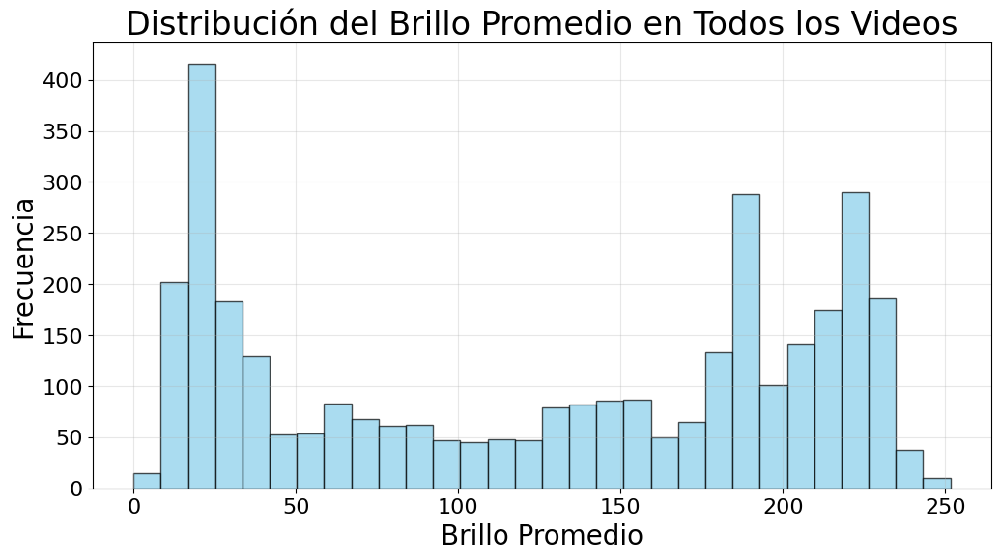

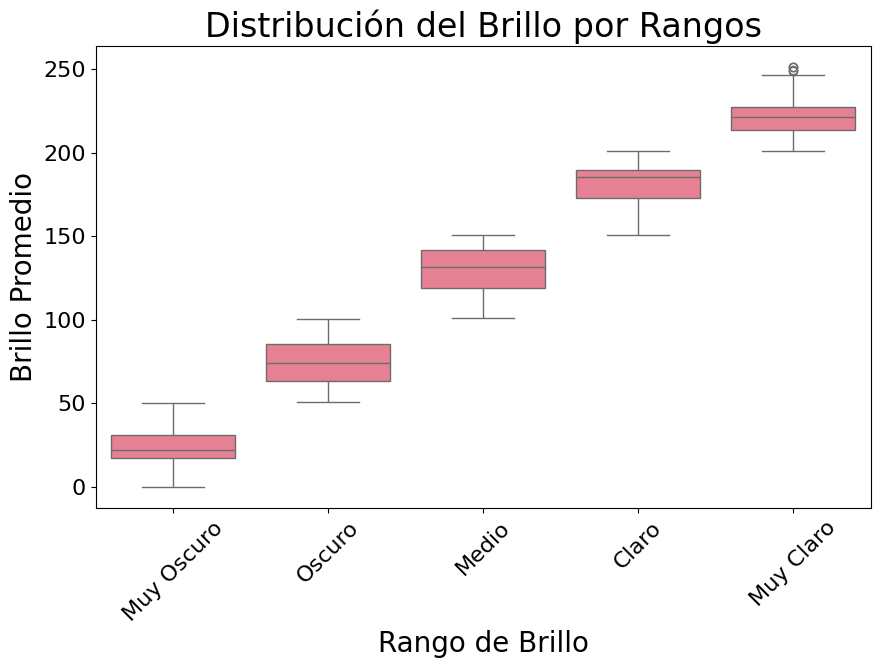

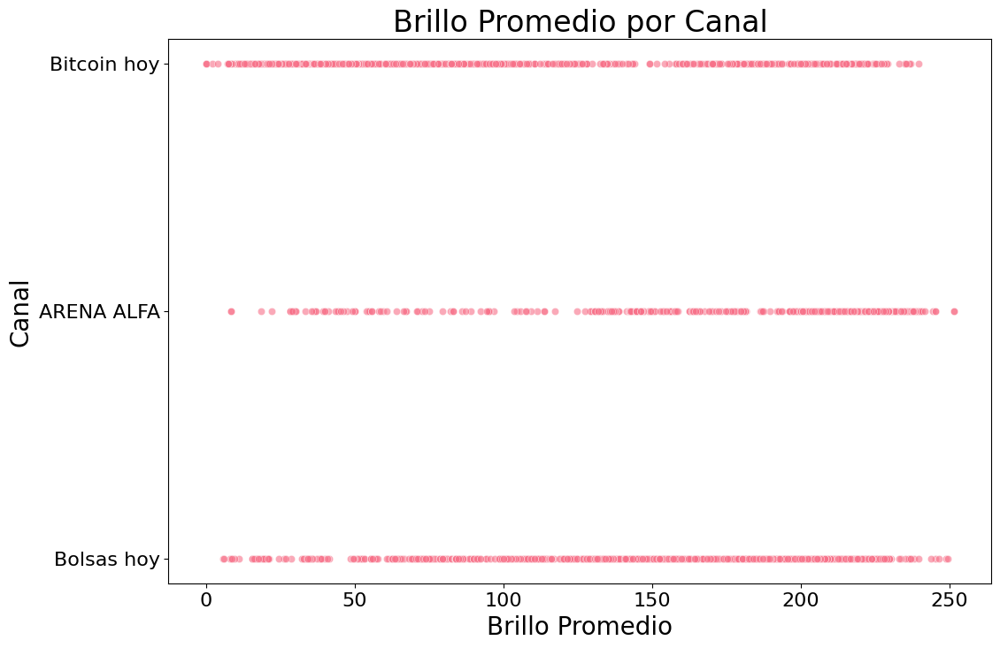

Top 10 videos más brillantes:
   video_id       mean
JIZLh31Rxqc 238.033050
txASAb9BMYo 234.178765
ds8BFU1HmtY 233.201883
Tz58dl9uEGc 230.741160
piGuWWCBD-k 230.507996
uTQvlJCJ1ao 229.551899
ogGD_yLsg8o 229.220877
47FHkAv_5tA 228.387795
R-yEmBc6uqM 228.294974
3wLkSO-ZQCs 227.854113

Top 10 videos más oscuros:
   video_id      mean
XBt2xcZh0Wg 16.495507
rPB5pHtbL5U 16.244820
bnG0Lif9UdE 16.027023
Vtgl_GVho8U 15.846815
qMte0G2o69Y 15.817820
QxIY8_3p_9w 15.225940
GQkIhgxtzPE 14.499938
zn61guGTjis 13.645332
ydITgWbqm2A 13.398035
Y_Qk0bIBJcw 13.364620


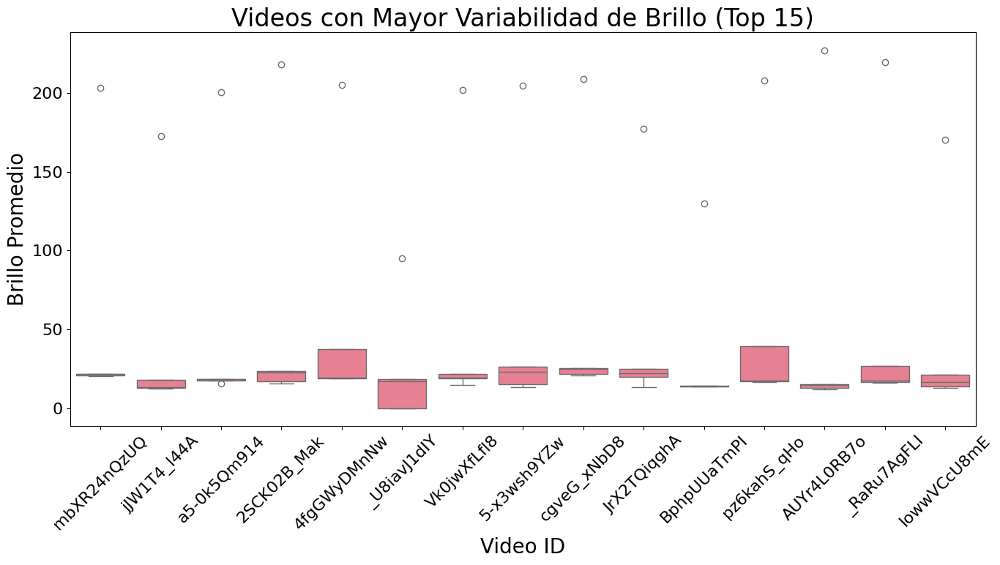

In [66]:
# ----------- 5. ANÁLISIS DE COLOR Y BRILLO -----------
frame_sample = []
for i, row in df_videos_descargados.iterrows():
    n = min(5, len(row['frame_paths']))
    for fp in np.random.choice(row['frame_paths'], n, replace=False):
        img = cv2.imread(fp)
        frame_sample.append({
            'video_id': row['video_id'],
            'mean_brightness': img.mean(),
            'mean_R': img[:,:,2].mean(),
            'mean_G': img[:,:,1].mean(),
            'mean_B': img[:,:,0].mean()
        })
df_colors = pd.DataFrame(frame_sample)

# OPCIÓN 1: Histograma del brillo promedio (más claro)
plt.figure(figsize=(12, 6))
plt.hist(df_colors['mean_brightness'], bins=30, alpha=0.7, color='skyblue', edgecolor='black')
plt.xlabel('Brillo Promedio')
plt.ylabel('Frecuencia')
plt.title('Distribución del Brillo Promedio en Todos los Videos')
plt.grid(True, alpha=0.3)
plt.show()

# OPCIÓN 2: Boxplot agrupado por rangos de brillo
df_colors['brightness_range'] = pd.cut(df_colors['mean_brightness'], 
                                      bins=5, 
                                      labels=['Muy Oscuro', 'Oscuro', 'Medio', 'Claro', 'Muy Claro'])
plt.figure(figsize=(10, 6))
sns.boxplot(data=df_colors, x='brightness_range', y='mean_brightness')
plt.xlabel('Rango de Brillo')
plt.ylabel('Brillo Promedio')
plt.title('Distribución del Brillo por Rangos')
plt.xticks(rotation=45)
plt.show()

# OPCIÓN 3: Scatter plot con brillo vs canal (si tienes info del canal)
if 'channel_name' in df_videos_descargados.columns:
    # Agregar info del canal al dataframe de colores
    channel_mapping = df_videos_descargados.set_index('video_id')['channel_name'].to_dict()
    df_colors['channel'] = df_colors['video_id'].map(channel_mapping)
    
    plt.figure(figsize=(12, 8))
    sns.scatterplot(data=df_colors, x='mean_brightness', y='channel', alpha=0.6)
    plt.xlabel('Brillo Promedio')
    plt.ylabel('Canal')
    plt.title('Brillo Promedio por Canal')
    plt.show()

# OPCIÓN 4: Top 10 videos más brillantes y más oscuros
brightness_stats = df_colors.groupby('video_id')['mean_brightness'].agg(['mean', 'std', 'count']).reset_index()
brightness_stats = brightness_stats.sort_values('mean', ascending=False)

print("Top 10 videos más brillantes:")
print(brightness_stats.head(10)[['video_id', 'mean']].to_string(index=False))

print("\nTop 10 videos más oscuros:")
print(brightness_stats.tail(10)[['video_id', 'mean']].to_string(index=False))

# OPCIÓN 5: Boxplot solo de los videos con mayor variabilidad
brightness_stats['variability'] = brightness_stats['std'] / brightness_stats['mean']
top_variable_videos = brightness_stats.nlargest(15, 'variability')['video_id'].tolist()

plt.figure(figsize=(14, 8))
variable_data = df_colors[df_colors['video_id'].isin(top_variable_videos)]
sns.boxplot(data=variable_data, x='video_id', y='mean_brightness')
plt.xlabel('Video ID')
plt.ylabel('Brillo Promedio')
plt.title('Videos con Mayor Variabilidad de Brillo (Top 15)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()